In [20]:
import pandas as pd
import numpy as np
import nltk
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer
from transformers import BertTokenizer, BertModel
import torch
from node2vec import Node2Vec
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import networkx as nx
import re
nltk.download('punkt')
nltk.download('stopwords')

np.random.seed(42)
seed = 42

[nltk_data] Downloading package punkt to /Users/choedahui/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/choedahui/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [47]:
df = pd.read_csv('pubmed_sample_data.csv')

In [48]:
def lowercase_strings(value):
    if isinstance(value, str):
        return value.lower()
    return value

df = df.applymap(lowercase_strings)

In [49]:
def extract_topic(value):
    if isinstance(value, str):
        match = re.search(r"stringelement\('([^']+)'", value)
        if match:
            return match.group(1)
    return None

df['keyword_stringelement'] = df['Keyword List'].apply(extract_topic)

In [50]:
def remove_stopwords(text):
    stop_words = set(stopwords.words('english'))
    word_tokens = word_tokenize(text)
    filtered_text = [word for word in word_tokens if word.lower() not in stop_words]
    return ' '.join(filtered_text)

# Assuming 'df' is your DataFrame
df['Abstract'] = df['Abstract'].apply(remove_stopwords)

In [51]:
df.head(3)

,Title,Abstract,Journal,Language,Year,Month,PMID,DOI,Authors,Volume,Keyword List,cited,cited_num,keyword_stringelement
0,a primer on the oxdna model of dna: when to us...,oxdna model deoxyribonucleic acid applied wide...,frontiers in molecular biosciences,eng,2021.0,NaN,34235181,10.3389/fmolb.2021.693710,"['a sengar', 't e ouldridge', 'o henrich', 'l ...",8,"listelement([stringelement('biophysics', attri...","['37833326', '37713594', '37621774', '37520280...",11,biophysics
1,comparative protein structure modeling using m...,comparative protein structure modeling predict...,current protocols in bioinformatics,eng,2016.0,jun,27322406,10.1002/cpbi.3,"['benjamin webb', 'andrej sali']",54,"listelement([stringelement('modeller', attribu...","['37901543', '37896909', '37891932', '37836743...",961,modeller
2,modelbricks-modules for reproducible modeling ...,computational models biology built intended ``...,npj systems biology and applications,eng,2019.0,NaN,31602314,10.1038/s41540-019-0114-3,"['ann e cowan', 'pedro mendes', 'michael l bli...",5,"listelement([stringelement('complexity', attri...","['37503075', '36745660', '34644304', '33758926...",5,complexity


In [52]:
df['contents'] = df['Title']+df['Abstract']
df['contents2'] = df['Title']+df['Abstract']+df['keyword_stringelement']
df['contents3'] = df['PMID'].astype('str')+df['Title']+df['Abstract']+df['keyword_stringelement']+df['cited']

In [53]:
df = df.reset_index()

In [12]:
data = df.to_dict(orient='records')

graph = nx.Graph()
for item in data:
    graph.add_node(item['index'], label=item['contents'])

edges = [(edge[0], edge[1]) for edge in graph.edges()]

node2vec_graph = Node2Vec(graph, dimensions=128, walk_length=10, num_walks=5)
model = node2vec_graph.fit(window=5, min_count=1)

node_embeddings = np.array([model.wv[str(node)] for node in graph.nodes()])


Generating walks (CPU: 1): 100%|██████████| 5/5 [00:00<00:00, 127.96it/s]


Generating walks (CPU: 1): 100%|██████████| 5/5 [00:00<00:00, 112.74it/s]


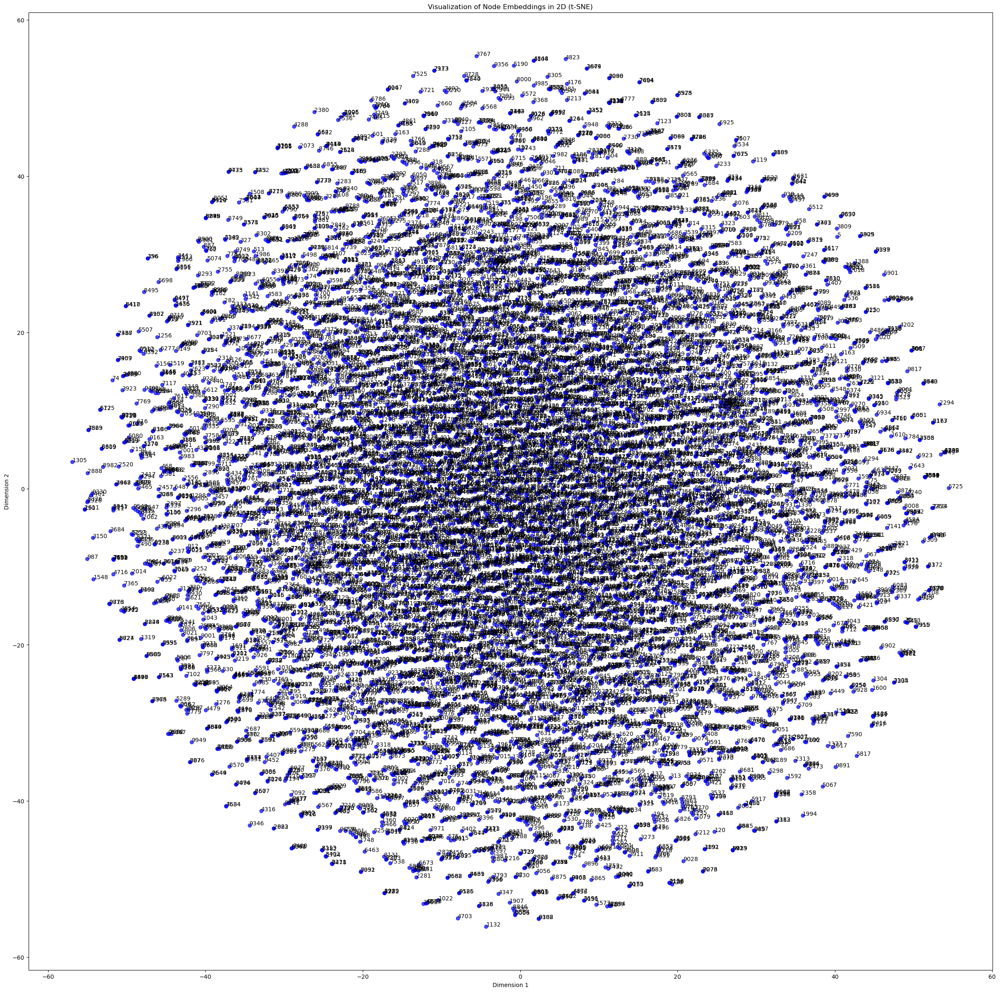

In [10]:
tsne = TSNE(n_components=2, random_state=42)
node_embeddings_2d = tsne.fit_transform(node_embeddings)

plt.figure(figsize=(30, 30))
plt.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], color='blue', alpha=0.7)
plt.title("Visualization of Node Embeddings in 2D (t-SNE)")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

for i, label in enumerate(graph.nodes()):
    plt.annotate(label, (node_embeddings_2d[i, 0], node_embeddings_2d[i, 1]))

plt.show()

In [47]:
tsne = TSNE(n_components=2, random_state=42)
node_embeddings_2d = tsne.fit_transform(node_embeddings)

plt.figure(figsize=(100, 100))
plt.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], color='blue', alpha=0.7)
plt.title("Visualization of Node Embeddings in 2D (t-SNE)")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

for i, label in enumerate(graph.nodes()):
    plt.annotate(label, (node_embeddings_2d[i, 0], node_embeddings_2d[i, 1]))

plt.show()

Generating walks (CPU: 1): 100%|██████████| 5/5 [00:00<00:00, 6710.89it/s]


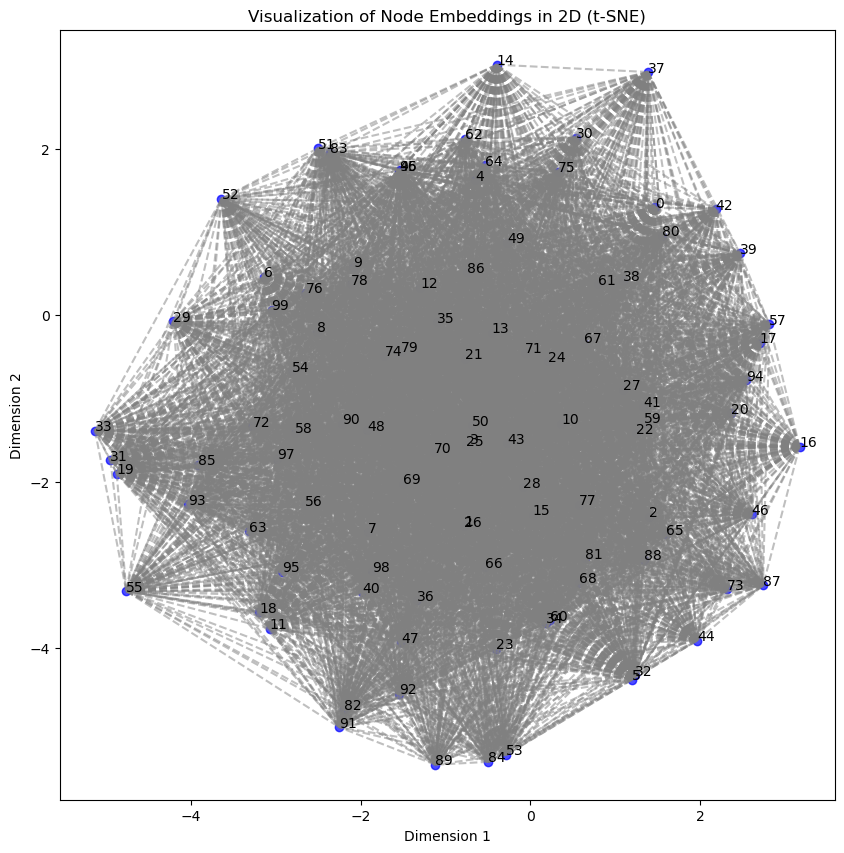

In [19]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

ltest= df.iloc[:100]
data = ltest.to_dict(orient='records')

graph = nx.Graph()
for item in data:
    graph.add_node(item['index'], label=item['contents'])

node2vec_graph = Node2Vec(graph, dimensions=128, walk_length=10, num_walks=5, seed=seed)
model = node2vec_graph.fit(window=5, min_count=1)

node_embeddings = np.array([model.wv[str(node)] for node in graph.nodes()])


tsne = TSNE(n_components=2, random_state=42)
node_embeddings_2d = tsne.fit_transform(node_embeddings)

plt.figure(figsize=(10, 10))
plt.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], color='blue', alpha=0.7)
plt.title("Visualization of Node Embeddings in 2D (t-SNE)")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

for i, label in enumerate(graph.nodes()):
    plt.annotate(label, (node_embeddings_2d[i, 0], node_embeddings_2d[i, 1]))
    for j in range(i+1, len(graph.nodes())):
        plt.plot([node_embeddings_2d[i, 0], node_embeddings_2d[j, 0]],
                [node_embeddings_2d[i, 1], node_embeddings_2d[j, 1]],
                color='gray', linestyle='--', alpha=0.5)

plt.show()

Generating walks (CPU: 1): 100%|██████████| 5/5 [00:00<00:00, 2681.09it/s]


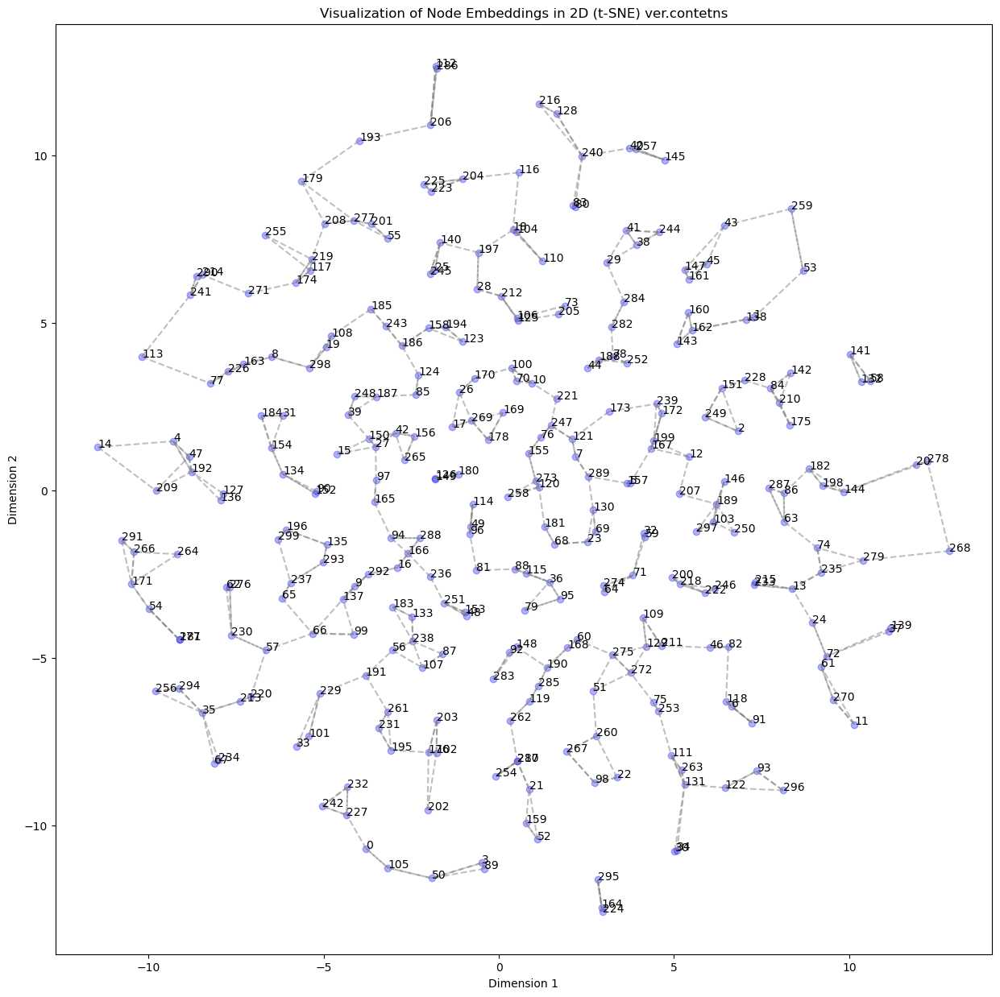

In [54]:
ltest= df.iloc[:300]
data = ltest.to_dict(orient='records')

graph = nx.Graph()
for item in data:
    graph.add_node(item['index'], label=item['contents'])

node2vec_graph = Node2Vec(graph, dimensions=128, walk_length=10, num_walks=5, seed=seed)
model = node2vec_graph.fit(window=5, min_count=1)

node_embeddings = np.array([model.wv[str(node)] for node in graph.nodes()])

tsne = TSNE(n_components=2, random_state=seed)
node_embeddings_2d = tsne.fit_transform(node_embeddings)

nbrs = NearestNeighbors(n_neighbors=3).fit(node_embeddings_2d)
distances, indices = nbrs.kneighbors(node_embeddings_2d)

plt.figure(figsize=(15, 15))
plt.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], color='blue', alpha=0.3)
plt.title("Visualization of Node Embeddings in 2D (t-SNE) ver.contetns")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

for i, label in enumerate(graph.nodes()):
    plt.annotate(label, (node_embeddings_2d[i, 0], node_embeddings_2d[i, 1]))
    for j in indices[i, 1:]:
        plt.plot([node_embeddings_2d[i, 0], node_embeddings_2d[j, 0]],
                [node_embeddings_2d[i, 1], node_embeddings_2d[j, 1]],
                color='gray', linestyle='--', alpha=0.5)

plt.show()

In [33]:
ltest.iloc[[295,164,224]]['Title'].values
'''
['척수 손상에서 nmes 유발 무릎 확장의 근골격 모델링.',
'생체시뮬레이션 모델의 정성적 인과분석.',
'biocrnpyler: 다양한 맥락에서 생체분자 부품의 화학 반응 네트워크를 컴파일합니다.']
'''


array(['musculo-skeletal modelling of nmes-evoked knee extension in spinal cord injury.',
       'qualitative causal analyses of biosimulation models.',
       'biocrnpyler: compiling chemical reaction networks from biomolecular parts in diverse contexts.'],
      dtype=object)

In [29]:
ltest.iloc[[27,41,59,22]]['Title'].values
'''
['주요 우울증 장애의 임상 치료 경로를 모델링하기 위해 환자 파트너와 협력: 증거와 실제 경험을 혼합하는 이점.',
'데이터 캡처와 모델 복잡성 사이의 균형 탐구: 단일클론 항체에 적용되는 정량적 임상 약리학 접근법.',
'복잡도 감소 및 매개변수 추정을 사용하여 지역 모델 개선',
'LCA 기능 로드맵: 제품 시스템 모델 설명 및 개정.']
'''

array(['collaborating with patient partners to model clinical care pathways in major depressive disorder: the benefits of mixing evidence and lived experience.',
       'the quest for balance between capturing data and model complexity: a quantitative clinical pharmacology approach applied to monoclonal antibodies.',
       'improving a regional model using reduced complexity and parameter estimation.',
       'lca capability roadmap: product system model description and revision.'],
      dtype=object)

In [81]:
node_embeddings # index

{'0': array([-6.4075459e-04, -5.4288832e-03, -1.4517596e-03,  6.2002670e-03,
        -8.5976720e-04, -4.0264595e-03, -6.2860036e-03, -4.5857010e-03,
        -2.4972251e-03,  6.0314368e-03, -5.6435419e-03,  1.1250768e-03,
        -5.9581362e-05,  3.0771364e-03, -6.2066149e-03,  6.2113116e-03,
        -2.1788497e-03,  4.1403119e-03, -7.4270563e-03,  3.9757229e-03,
        -6.4445138e-03, -2.5404515e-03, -9.2756096e-04, -2.8454736e-03,
        -5.7216361e-04,  1.8337741e-05,  3.5231896e-03, -1.7510112e-03,
        -3.1316262e-03, -4.8226416e-03,  6.5033818e-03,  3.6037974e-03,
         7.1106916e-03,  4.2840131e-03, -3.6024824e-03,  6.4677466e-03,
        -5.4363990e-03,  2.3784032e-03, -2.6215967e-03,  2.0921044e-04,
         2.9375702e-03, -2.2045346e-03, -3.4533814e-03, -1.5228838e-03,
         4.0654000e-04,  5.0430158e-03, -4.5743873e-03,  3.6457246e-03,
        -2.8977422e-03, -6.2078536e-03, -4.3787844e-03,  1.4499128e-03,
         6.8659764e-03,  6.1513381e-03,  7.1694981e-03,  5.

In [85]:
node_embeddings.keys()

dict_keys(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71', '72', '73', '74', '75', '76', '77', '78', '79', '80', '81', '82', '83', '84', '85', '86', '87', '88', '89', '90', '91', '92', '93', '94', '95', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106', '107', '108', '109', '110', '111', '112', '113', '114', '115', '116', '117', '118', '119', '120', '121', '122', '123', '124', '125', '126', '127', '128', '129', '130', '131', '132', '133', '134', '135', '136', '137', '138', '139', '140', '141', '142', '143', '144', '145', '146', '147', '148', '149', '150', '151', '152', '153', '154', '155', '156', 

In [88]:
node_embeddings['0'].shape

(128,)

In [ ]:
ltest= df.iloc[:300]
data = ltest.to_dict(orient='records')

graph = nx.Graph()
for item in data:
    graph.add_node(item['index'], label=item['index'])

node2vec_graph = Node2Vec(graph, dimensions=128, walk_length=10, num_walks=5,seed=seed)
model = node2vec_graph.fit(window=5, min_count=1)
node_embeddings = {str(node): model.wv[str(node)] for node in graph.nodes()}

Generating walks (CPU: 1): 100%|██████████| 5/5 [00:00<00:00, 3387.42it/s]


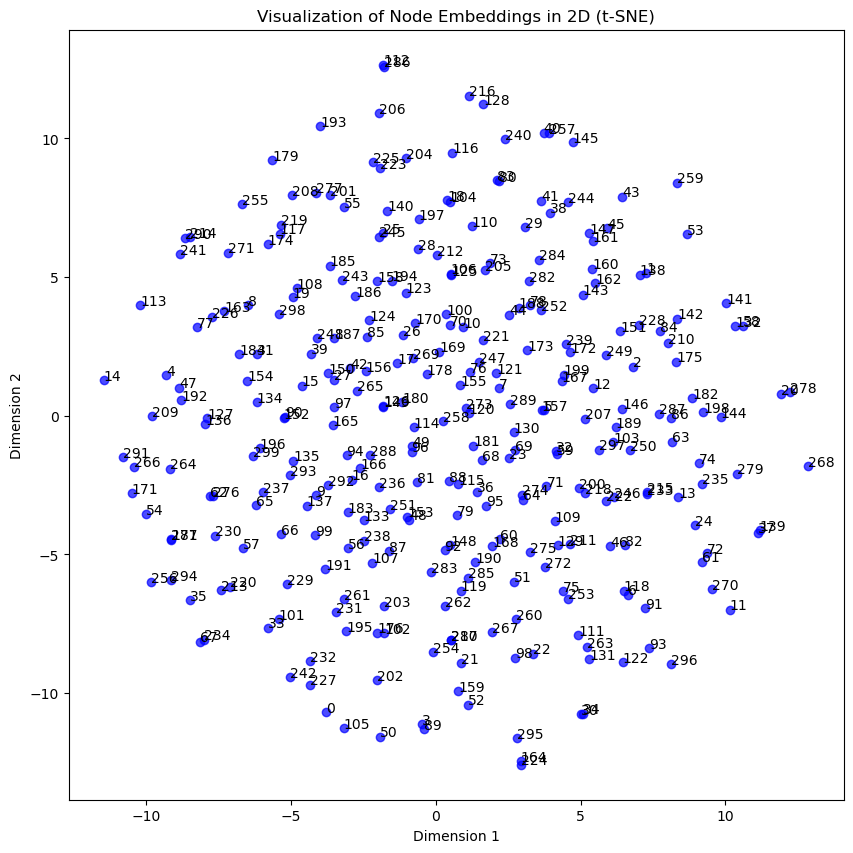

In [80]:
import networkx as nx
from node2vec import Node2Vec
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import pandas as pd

ltest= df.iloc[:300]
data = ltest.to_dict(orient='records')

graph = nx.Graph()
for item in data:
    graph.add_node(item['index'], label=item['index'])

node2vec_graph = Node2Vec(graph, dimensions=128, walk_length=10, num_walks=5,seed=seed)
model = node2vec_graph.fit(window=5, min_count=1)
node_embeddings = {str(node): model.wv[str(node)] for node in graph.nodes()}

node_indices, embeddings = zip(*node_embeddings.items())

embeddings_array = np.array(embeddings)

tsne = TSNE(n_components=2, random_state=42)
node_embeddings_2d = tsne.fit_transform(embeddings_array)

plt.figure(figsize=(10, 10))
plt.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], color='blue', alpha=0.7)
plt.title("Visualization of Node Embeddings in 2D (t-SNE)")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

for i, label in enumerate(node_indices):
    plt.annotate(label, (node_embeddings_2d[i, 0], node_embeddings_2d[i, 1]))

plt.show()

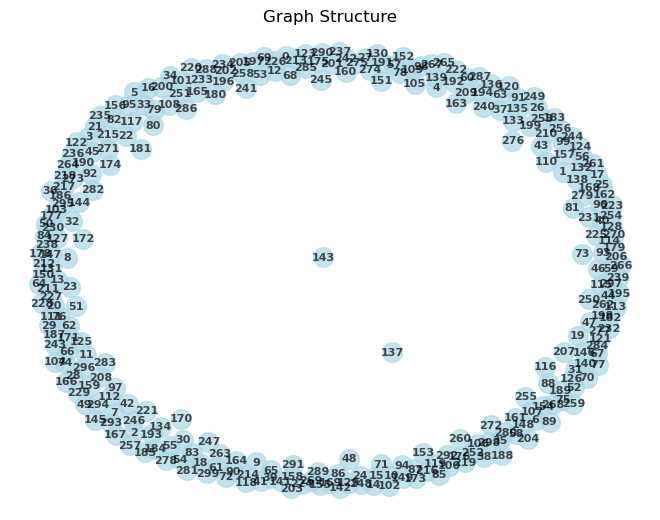

In [82]:
pos = nx.spring_layout(graph) 
nx.draw(graph, pos, with_labels=True, font_size=8, node_size=200, node_color='lightblue', font_color='black', font_weight='bold', alpha=0.7)
plt.title("Graph Structure")
plt.show()

Generating walks (CPU: 1): 100%|██████████| 5/5 [00:00<00:00, 5726.79it/s]


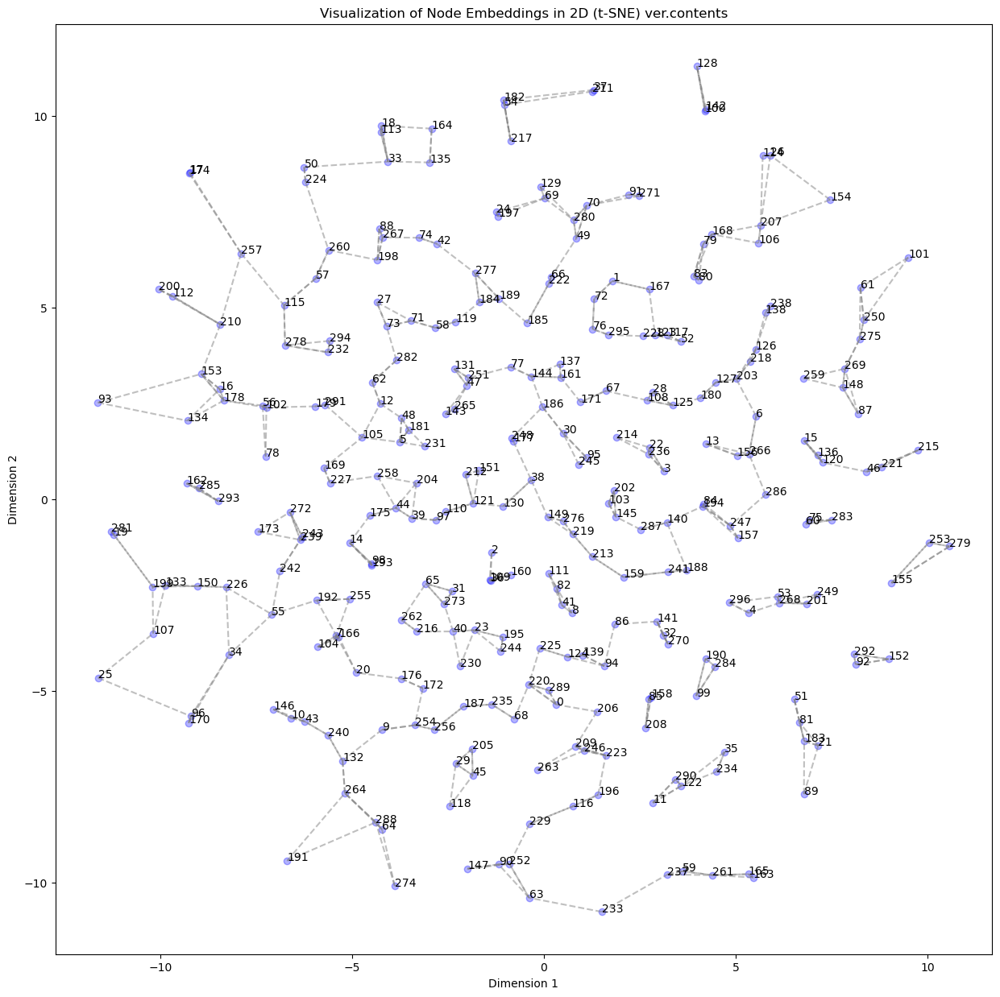

In [63]:
ltest= df.iloc[:300]
data = ltest.to_dict(orient='records')

graph = nx.Graph()
for item in data:
    graph.add_node(item['contents'], label=item['index'])

node2vec_graph = Node2Vec(graph, dimensions=128, walk_length=10, num_walks=5, seed=seed)
model = node2vec_graph.fit(window=5, min_count=1)

node_embeddings = np.array([model.wv[str(node)] for node in graph.nodes()])

tsne = TSNE(n_components=2, random_state=seed)
node_embeddings_2d = tsne.fit_transform(node_embeddings)

nbrs = NearestNeighbors(n_neighbors=3).fit(node_embeddings_2d)
distances, indices = nbrs.kneighbors(node_embeddings_2d)

plt.figure(figsize=(15, 15))
plt.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], color='blue', alpha=0.3)
plt.title("Visualization of Node Embeddings in 2D (t-SNE) ver.contents")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

for i, label in enumerate(graph.nodes()):
    plt.annotate(i, (node_embeddings_2d[i, 0], node_embeddings_2d[i, 1]))
    for j in indices[i, 1:]:
        plt.plot([node_embeddings_2d[i, 0], node_embeddings_2d[j, 0]],
                [node_embeddings_2d[i, 1], node_embeddings_2d[j, 1]],
                color='gray', linestyle='--', alpha=0.5)

plt.show()

Generating walks (CPU: 1): 100%|██████████| 5/5 [00:00<00:00, 5518.82it/s]


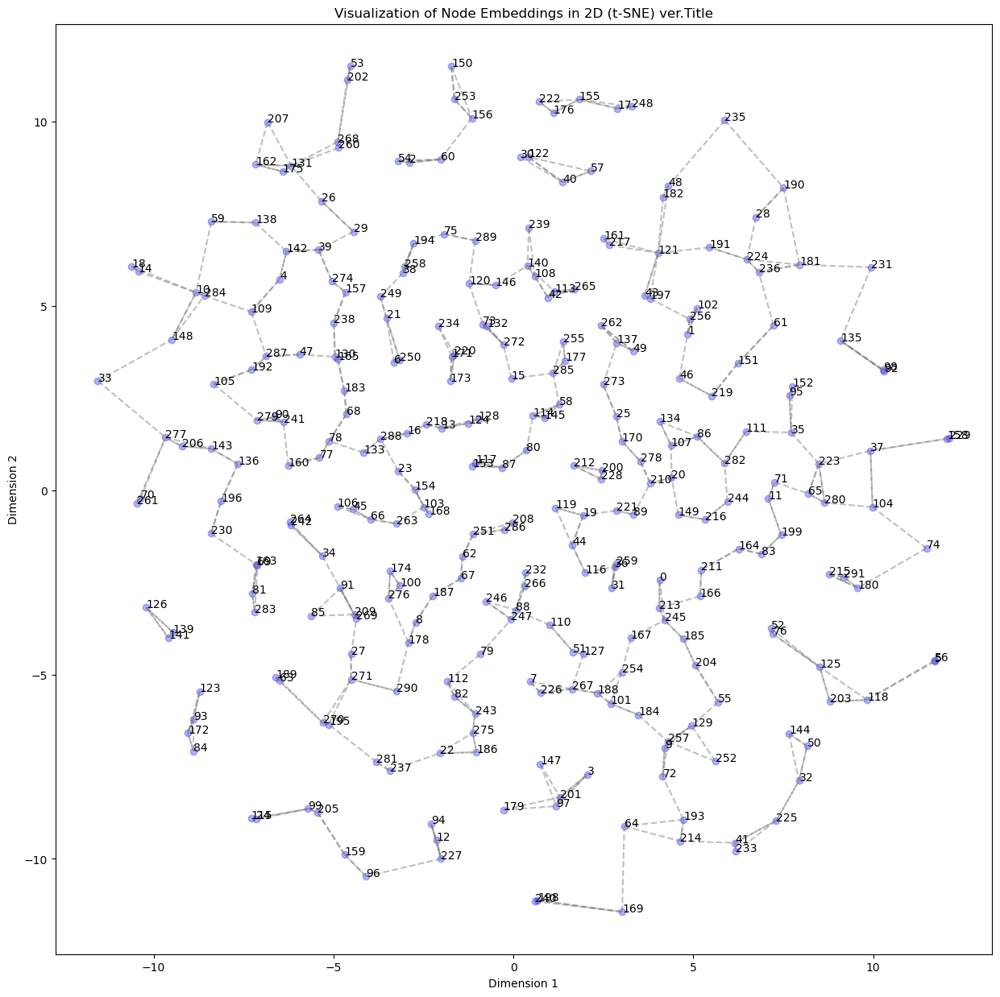

In [62]:
ltest= df.iloc[:300]
data = ltest.to_dict(orient='records')

graph = nx.Graph()
for item in data:
    graph.add_node(item['Title'], label=item['index'])

node2vec_graph = Node2Vec(graph, dimensions=128, walk_length=10, num_walks=5, seed=seed)
model = node2vec_graph.fit(window=5, min_count=1)

node_embeddings = np.array([model.wv[str(node)] for node in graph.nodes()])

tsne = TSNE(n_components=2, random_state=seed)
node_embeddings_2d = tsne.fit_transform(node_embeddings)

nbrs = NearestNeighbors(n_neighbors=3).fit(node_embeddings_2d)
distances, indices = nbrs.kneighbors(node_embeddings_2d)

plt.figure(figsize=(15, 15))
plt.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], color='blue', alpha=0.3)
plt.title("Visualization of Node Embeddings in 2D (t-SNE) ver.Title")
plt.xlabel("Dimension 1")
plt.ylabel("Dimension 2")

for i, label in enumerate(graph.nodes()):
    plt.annotate(i, (node_embeddings_2d[i, 0], node_embeddings_2d[i, 1]))
    for j in indices[i, 1:]:
        plt.plot([node_embeddings_2d[i, 0], node_embeddings_2d[j, 0]],
                [node_embeddings_2d[i, 1], node_embeddings_2d[j, 1]],
                color='gray', linestyle='--', alpha=0.5)

plt.show()

In [15]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

data = df.to_dict(orient='records')

def embed_text_bert(text):
    tokens = tokenizer(text, return_tensors='pt', truncation=True, padding=True)
    with torch.no_grad():
        outputs = model(**tokens)
    embeddings = outputs.last_hidden_state.mean(dim=1).squeeze().numpy()
    return embeddings

for item in data:
    item['contents_emb_mean'] = embed_text_bert(item['contents']).mean(axis=0).reshape(1, -1)

In [17]:
data[0]['contents_emb_mean'].shape

(1, 1)

In [18]:
data

[{'level_0': 0,
  'index': 0,
  'Title': 'a primer on the oxdna model of dna: when to use it, how to simulate it and how to interpret the results.',
  'Abstract': "the oxdna model of deoxyribonucleic acid has been applied widely to systems in biology, biophysics and nanotechnology. it is currently available via two independent open source packages. here we present a set of clearly documented exemplar simulations that simultaneously provide both an introduction to simulating the model, and a review of the model's fundamental properties. we outline how simulation results can be interpreted in terms of-and feed into our understanding of-less detailed models that operate at larger length scales, and provide guidance on whether simulating a system with oxdna is worthwhile.",
  'Journal': 'frontiers in molecular biosciences',
  'Language': 'eng',
  'Year': 2021.0,
  'Month': nan,
  'PMID': 34235181,
  'DOI': '10.3389/fmolb.2021.693710',
  'Authors': "['a sengar', 't e ouldridge', 'o henrich'

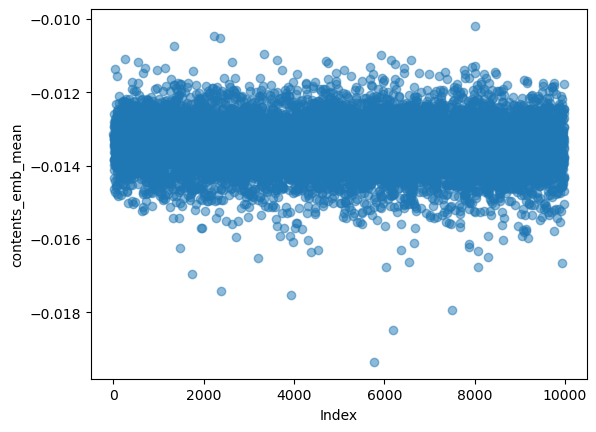

In [20]:
import matplotlib.pyplot as plt

indexes = [item['index'] for item in data]
emb_means = [item['contents_emb_mean'][0][0] for item in data]

plt.scatter(indexes, emb_means, alpha=0.5)
plt.xlabel('Index')
plt.ylabel('contents_emb_mean')
plt.show()


In [23]:
import numpy as np
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity

emb_means = [item['contents_emb_mean'][0][0] for item in data]

emb_means_2d = np.array(emb_means).reshape(-1, 1)

similarity_matrix = cosine_similarity(emb_means_2d)

plt.figure(figsize=(10, 8))
sns.heatmap(similarity_matrix, annot=True, cmap='viridis', xticklabels=indexes, yticklabels=indexes)
plt.title('Cosine Similarity between contents_emb_mean based on Index')
plt.show()


KeyboardInterrupt: 

Error in callback <function _draw_all_if_interactive at 0x28d352670> (for post_execute):


KeyboardInterrupt: 

In [36]:
for item in data:
    item['contents_emb_mean'] = embed_text_bert(item['contents']).mean(axis=0).reshape(1, -1)

In [ ]:
data[0]['contents_emb_mean']

array([[-0.01313758]], dtype=float32)

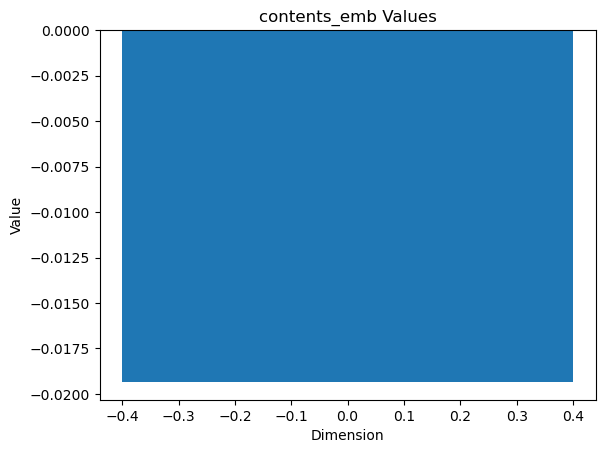

In [38]:
import matplotlib.pyplot as plt

embeddings = [item['contents_emb_mean'].flatten() for item in data]


embedding_array = np.array(embeddings)


plt.bar(range(embedding_array.shape[1]), embedding_array.flatten())
plt.title('contents_emb Values')
plt.xlabel('Dimension')
plt.ylabel('Value')
plt.show()

In [39]:
import matplotlib.pyplot as plt

embeddings = [item['contents_emb'].flatten() for item in data]
mean_embeddings = [item['contents_emb_mean'].flatten() for item in data]

embedding_array = np.array(embeddings)
mean_embedding_array = np.array(mean_embeddings)

plt.scatter(embedding_array[:, 0], embedding_array[:, 1], label='Embeddings')
plt.scatter(mean_embedding_array[:, 0], mean_embedding_array[:, 1], label='Mean Embeddings', marker='x')
plt.xlabel('1')
plt.ylabel('2')
plt.legend()
plt.show()


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (9992,) + inhomogeneous part.